In [1]:
%matplotlib ipympl


import comet_ml #must be before torch
from pyFiles.helper import ReshapeTransform
import mpl_interactions.ipyplot as iplt
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
import numpy as np

from scipy.integrate import solve_ivp

from typing import Any, Callable, Dict, Optional, Sequence, Tuple, Union, List

from numba import jit

import random

from tqdm.notebook import tqdm

import pickle

from sklearn.datasets import fetch_openml
#from mpl2latex import mpl2latex, latex_figsize
#import mpl2latex
import matplotlib.animation as animation
from IPython.display import HTML


import torch
from torch import nn
import torch.nn.functional as F
from torch.optim.optimizer import Optimizer, required

from torchvision.datasets import MNIST
from torch.utils.data import DataLoader, random_split
from torchvision import transforms
import pytorch_lightning as pl
from pytorch_lightning import Trainer
from pytorch_lightning.loggers import CometLogger


from collections import namedtuple
from functools import partial

#
#from helper import ReshapeTransform

from datetime import datetime
import os

: 

: 

## Model's requirements

1. **Locality**:
- Changes in a synapse $w_{AB}$ connecting A to B should be locally determined, i.e. proportional to the activity of the pre-synaptic cell (A) and (a  function of) the activity of the post-synaptic cell (B). Traditionally ANNs trained with backpropagation do are not local.
- Changes in a synapse $w_{AB}$ may be positive to implement Long Term Potentiation (LTP, that happens with a high level of post-synaptic activity)  or negative to implement Long Term Depression (LTD, that happens with a low level of post-synaptic activity). 

2. **Competition**:
Weights cannot be all arbitrarily high, since resources for creating synapses are finite and shared (an organism must maintain homeostasis).
Thus, rising a weight means lowering another, i.e. weights compete with each other.
Mathematically, this means that weights should be normalized.

3. **Sparsity**:
It is more efficient to have few high weights and many zero weights, than all low weights. Only the “important” connections should be maintained.
Mathematically, the normalization condition from before should emphasize large weights more than low ones.

4. **Selectivity**:
Different neurons should be strongly activated by different patterns. There should not be many neurons all reacting to the same pattern.
In other words, if a neuron reacts strongly to a pattern, other neurons should not “specialize” on it.

To implement our model we need two rules:

$$
\begin{cases}
\tau \dfrac{dh}{dt} \quad = \quad = -h + \bar{w} \cdot \bar{v}, \quad \quad \quad \text{Neuron dynamics}
\\
\\
\tau_w \dfrac{d\bar{w}}{dt} = h\bar{v} , \quad \quad \quad \text{Synaptic plasticity}
\end{cases}
$$

where $h$ denotes the activities of the hidden neuron.

\
\
\
This way we have implemented locality but weights would grow indefinitely.
Indeed,

$$
\dfrac{d||\bar{w}||_2^2}{dt} \equiv \dfrac{d\bar{w}\cdot\bar{w}}{dt} = 2\bar{w}\cdot\dfrac{d\bar{w}}{dt} = \dfrac{2}{\tau}h^2 \ge 0
$$

The next step is to introduce competition and this is achieved through normalization, to do this we make use of the Oja rule leading to:

$$
\tau_w \dfrac{d\bar{w}}{dt} = h(R^2\bar{v} - h\bar{w})
$$

where $R$ is a constant that determines the radius of the sphere of weights.

at stationarity, we have:

$$
|w_1|^2 + \dots + |w_n|^2 = R^2.
$$


To implement sparsity we replace the Euclidean norm (also the one used in the Oja rule) with a generic Lebesgue p-norm. Our equations become:

$$
\begin{cases}
\tau \dfrac{dh}{dt} \quad = \quad = -h + \langle \bar{w}, \bar{v} \rangle_p, \quad \quad \quad \text{Neuron dynamics}
\\
\\
\tau_w \dfrac{d\bar{w}}{dt} = h[R^p \bar{v} - h\bar{w}] , \quad \quad \quad \text{Synaptic plasticity}
\end{cases}
$$

Now weights converge to a sphere of radius $R$ defined with the $L^p$ norm,

$$
|w_1|^p + \dots + |w_n|^p = R^p.
$$

To see this we consider the time derivative of the $p$ norm of the weight vector:

$$
\tau_w \dfrac{d}{dt}\langle \bar{W}, \bar{W} \rangle = p\tau_w \langle \bar{W}, \dfrac{d\bar{W}}{dt}\rangle = hp\cancel{\tau_w}\dfrac{1}{\cancel{\tau_w}}\langle \bar{W}, (R^p \bar{v} - h\bar{W}) \rangle =
$$
$$
=  hp(R^p\langle \bar{W}, \bar{v} \rangle - h\langle  \bar{W}, \bar{W} \rangle) = ph\langle \bar{W}, \bar{v} \rangle[R^p -\langle\bar{W}, \bar{W}\rangle]
$$

So, provided that $p \cdot h$ is greater than $0$, if the $p$ length vector $\bar{W}$ is less than R, its length is increases on the dynamic. Otherwise it decreases.

\
To introduce the concept of long therm depotentiation (**LTD**) we add a threshold so that:
$$
\tau_w \dfrac{d\bar{w}}{dt} = g(h)[R^p \bar{v} - h\bar{w}]; \quad \quad \quad g(h) = \begin{cases} 0 & \text{if} & h \lt 0 \\ -\Delta & \text{if} & 0 \le h \lt h_* \\ 1 & \text{if} & h_*  \le h\end{cases}
$$

The function $g$ implements temporal competition between patterns. The idea behind this choice is that the synapses of hidden units that are strongly drivenare are pushed toward the patterns that drive them, while the synapses of those hidden units that are driven slightly less are pushed away from these patterns.

In the lsat step we first generalized the retrieved equations to the case of multiple neurons and then we added the selectivity condition.\
The selectivity condition is implemented by adding a global lateral inhibition term between neurons. That is, if a neuron $\mu$ is active, it makes all other neurons less active.
\
\
We finally reach the following equations:

$$
\begin{cases}
\tau \dfrac{dh}{dt} \quad = \quad I_{\mu} -h_{\mu} - w_{inh}\sum\limits_{\nu \neq \mu} max(h_{\nu}, 0)
\\
\\
\tau_w \dfrac{d\bar{w}}{dt} = g(h_{\mu})[R^p v_i - h_{\mu}\bar{W_{\mu i}}]
\end{cases}
$$

Where $I_{mu} = \langle \bar{W}_{\mu}, \bar{v} \rangle_p$ and $w_{inh}$ is a parameters defining the strength of global inhibition.

\
\
This model is inherently slow because the sample need to be shown one at a time.\
Also, at every step, we need to evolve the dynamics, all of theis cannot be organized in batches and thus it is not suitable for GPU acceleration or other efficient implementation.
\
The idea to apply a fast algorithm is then the following:
- let $h^*_{\mu} = \langle \bar{W}_{mu}, \bar{v}$. Then we reorder the units so that $h^*_1 \gt \dots \gt h^*_n$.\
    The activation function is then computed as:\
    $$
    g(h_{\nu}) = \begin{cases} 1 & \text{for} & i = 1 & (h_1 \text{is highest})\\ -\Delta & \text{for} & i = 2 & (\text{or, in general, k})\\
    0 & \text{otherwhise}\end{cases}
    $$
    This can be applied in batches of data and involves only matrix operations.
- Discretize \dfrac{dW}{dt}, and compute a $\delta W$ instead. Normalize it such that $max(|\delta W|) = 1$, then update the weights as,
    $$
    W(t + 1) = W(t) + \nu\delta W(t)
    $$
    Where $\nu$ is the learning rate.


In [ ]:
class BioNeurons():
    """
    Simulate synaptic plasticity rule and dynamic equations from [1].
    
    [1]: "Unsupervised learning by competing hidden units", D. Krotov, J. J. Hopfield, 2019, 
         https://www.pnas.org/content/116/16/7723
    """
    
    def __init__(self,
                 input_dim : int = 2,
                 output_dim : int = 4,
                 w_inh : float = .63,
                 delta : float = .4,
                 h_star : float = 0.1,
                 tau : float = 1,
                 tau_L : float = 100,
                 lebesgue_p : float = 4.):
        """
        Set all the parameters for the simulation.
        
        Parameters
        ----------
        input_dim : int
            Number of visible units
        output_dim : int
            Number of hidden units
        w_inh : float
            Strength of global inhibition (from eq. 8 in [1]). Should be >= 0, and high enough so that
            only a small fraction of activations are positive in the steady-state (i.e. self.stationary_activations returns
            a small percentage of positive values).
        delta : float
            Strength of anti-Hebbian learning (from eq. 9 in [1]). 
        h_star : float
            Threshold for activation (from eq. 9 in [1])
        tau : float
            Dynamical time scale of individual neurons (from eq. 8 in [1])
        tau_L : float
            Time scale of learning dynamics (from eq. 3 in [1]). Should be >> tau.
        lebesgue_p : float
            Parameter for Lebesgue measure, used for defining an inner product (from eq. 2 in [1]).
        """
        
        #Store parameters
        self.input_dim  = input_dim
        self.output_dim = output_dim
        self.w_inh      = w_inh
        self.delta      = delta
        self.h_star     = h_star
        self.tau        = tau
        self.tau_L      = tau_L
        self.lebesgue_p = lebesgue_p
        
        #Set initial state
        self.activations = np.zeros(output_dim, dtype=float)
        self.weights     = np.random.normal(size=(output_dim, input_dim)) #normal size
        
        print(str(self))
        
    def __str__(self):
        return f"BioNeurons(input_dim={self.input_dim}, output_dim={self.output_dim}, w_inh={self.w_inh}, delta={self.delta}, lebesgue_p={self.lebesgue_p}, h_star={self.h_star}, tau={self.tau}, tau_L={self.tau_L})"
    
    def __repr__(self):
        return str(self)

    # In this mode, compilation will be deferred until the first function execution. 
    # Numba will infer the argument types at call time, and generate optimized code based on this information
    @jit
    def forward(self, inputs : np.ndarray) -> np.ndarray:
        """
        Sets the visible units to `inputs`, and propagates this signal through the weights to compute the network's output.
        
        Parameters
        ----------
        inputs : np.ndarray of shape (self.input_dim,)
            Vector with values for the input neurons
        
        Returns
        -------
        out : np.ndarray of shape (self.output_dim,)
            Vector with values for the hidden units (before activation).
        """
        
        return np.dot(self.weights, inputs)
    
    # Does not require the definition of an instance of the class; does not require self
    @staticmethod
    def currents(inputs : np.ndarray, weights : np.ndarray, lebesgue_p : float) -> np.ndarray:
        """
        Computes currents at each hidden neuron (eq. 8 from [1]). 
        
        Formula is:
        $$ I_\mu = <W, v>_\mu = \sum_i sgn(W_{\mu i}) |W_{\mu i}|^{p-1} v_i $$
        where p is self.lebesgue_p
        
        Parameters
        ----------
        inputs : np.ndarray of shape (self.input_dim,)
            Vector with values for the input neurons
        weights : np.ndarray of shape (self.output_dim, self.input_dim)
            Weights
        
        Returns
        -------
        currents : np.ndarray of shape (self.output_dim,)
            Vector with currents at each of the hidden neurons
        """
        
        return np.dot( np.sign(weights) * np.abs(weights) ** (lebesgue_p - 1), inputs )
    
    def dh_dt(self,
              t : float,
              y : np.ndarray,
              inputs : np.ndarray,
              weights : np.ndarray) -> np.ndarray:
        """
        Computes the right hand side of eq. 8 from [1], i.e. the time derivative of all neuron activations.
        
        Formula is:
            $$dh_\mu/dt = I_\mu - w_{inh} \sum_{\nu \neq \mu} \max(h_\nu, 0) - h_\mu $$ 
        where $I_\mu$ are the currents at the hidden neurons, and $h_\mu$ are their activations.
        
        Parameters
        ----------
        t : float
            Time instant, needed as interface to scipy.solve_ivp. 
        y : np.ndarray of shape (self.output_dim,)
            Value of hidden neurons
        inputs : np.ndarray of shape (self.input_dim,)
            Value of input neurons
        weights : np.ndarray of shape (self.output_dim, self.input_dim)
            Weights for the network
        
        Returns
        -------
        dh_dt : np.ndarray of shape (self.output_dim,)
            Vector containing the time derivative of each hidden neuron activation.
        """
        
        activations = y
        currents = self.currents(inputs, weights, lebesgue_p=self.lebesgue_p)
        
        positive_activations = activations * (activations > 0) #Set to 0 all the non-positive activations
        global_inhibition = np.sum(positive_activations) - positive_activations #Remove "self" activation by each term
        
        return (currents - self.w_inh * global_inhibition - activations) / self.tau
    
    def stationary_activations(self,
                               inputs : np.ndarray,
                               weights : np.ndarray) -> np.ndarray:
        """
        Computes the hidden neuron activations at stationarity, for a given value of the input neurons and weights of connections.
        For simplicity, this is done by numerically solving the differential equation (8 in [1]) for some large time.
        
        Parameters
        ----------
        inputs : np.ndarray of shape (self.input_dim,)
            Values for the input neurons
        weights : np.ndarray of shape (self.output_dim, self.input_dim)
            Weights
        
        Returns
        -------
        h* : np.ndarray of shape (self.output_dim,)
            Vector with the activations of the hidden neurons at stationarity
        """
    
        large_time = 5 * self.tau
        
        sol = solve_ivp(self.dh_dt, [0, large_time], np.zeros(self.output_dim), args=(inputs, weights), t_eval = [large_time])
        #Stationary solution does not depend on the initual condition, which is here set to 0.
        
        return sol.y.flatten()
    
    @staticmethod
    def g(activations : np.ndarray, h_star : float = 0.8, delta : float = 0.4) -> np.ndarray:
        """
        Activation function for training, implementing temporal competition between the patterns (eq. 9 from [1]). 
        
        Parameters
        ----------
        activations : np.ndarray of shape (self.output_dim,)
            Value of post-synaptic (hidden) neurons
        
        Returns
        -------
        post_act : np.ndarray of shape (self.output_dim,)
            Post-activation values for the hidden neurons.
        """
        
        return np.where(activations < 0, 0, np.where(activations <= h_star, -delta, 1.))
    
    def dW_dt(self,
              t : float,
              y : np.ndarray,
              inputs : np.ndarray,
              flatten : bool = False) -> np.ndarray:
        """
        Computes the right hand side of eq. 3 from [1], i.e. the time derivative of the weights. 
        It is computed in the quasi-stationary approximation, i.e. by setting the hidden units activations to their 
        stationary value at each step (which is a good approximation since the timescale for weight evolution is
        much larger than that of individual neuron dynamics).
        
        Formula is:
            $$dW_{\mu i}/dt = [g(h_\mu) (v_i - I_\mu W_{\mu i})] / \\tau_L$$
        where $v_i$ are the visible units, $h_\mu$ the hidden ones, $W_{\mu i}$ are the weights, and $I_\mu$ are the currents.
        
        Parameters
        ----------
        t : float
            Time instant, needed as interface to scipy.solve_ivp. 
        y : np.ndarray of shape (self.output_dim, self.input_dim), or (self.output_dim * self.input_dim,) if flatten=True
            Weights
        inputs : np.ndarray of shape (self.input_dim,)
            Value of input neurons
        flatten : bool
            If True, the output will be flattened to a 1D vector, which is compatible with scipy.solve_ivp.
        
        Returns
        -------
        dW_dt : np.ndarray of shape (self.output_dim, self.input_dim), or (self.output_dim * self.input_dim,) if flatten=True
            Time derivatives of weights
        """
        
        if flatten:
            weights = y.reshape(*self.weights.shape)
        else:
            weights = y
            
        #currents = self.currents(inputs, weights, lebesgue_p=self.lebesgue_p)
        
        activations = self.stationary_activations(inputs, weights)
        #Quasi-stationary approximation: use stationary value of activations, since their evolution is much faster
        
        post_activations = self.g(activations, h_star=self.h_star, delta=self.delta)
        
        result = (np.outer(post_activations, inputs) - ((post_activations * activations).reshape(-1, 1) * weights)) / self.tau_L
        
        return result.flatten() if flatten else result

Current computed in the above class:
$$ I_\mu = <W, v>_\mu = \sum_i sgn(W_{\mu i}) |W_{\mu i}|^{p-1} v_i $$

Time derivative of neurons activations computed in the dh_dt function of the above class:
$$\dfrac{dh_{\mu}}{dt} = I_\mu - w_{inh} \sum_{\nu \neq \mu} \max(h_\nu, 0) - h_\mu $$

Weight's time derivative computed in the dw_dt function of the above class:
$$\dfrac{dW_{\mu i}}{dt} = \dfrac{[g(h_\mu) (v_i - I_\mu W_{\mu i})]}{\tau_L}$$

In [ ]:
#Tests of the above class
neurons = BioNeurons(w_inh=.3)
print(f'''
    dh/dt = 
    {neurons.dh_dt(t = None, y = neurons.activations, inputs = np.random.normal(size=2), weights = neurons.weights)}

    hidden neurons activation at stationarity =
    {neurons.stationary_activations(np.random.normal(size=2), neurons.weights) }
    ''')

BioNeurons(input_dim=2, output_dim=4, w_inh=0.3, delta=0.4, lebesgue_p=4.0, h_star=0.1, tau=1, tau_L=100)

    dh/dt = 
    [-2.09175322  0.25295463  0.69219562 -2.00782759]

    hidden neurons activation at stationarity =
    [ 1.88770942 -0.92235744  2.94215016 -9.98829422]
    


### Effect of the inhibition parameter $w_{inh}$
With the above sliders we can see that, fixing the other parameters, $w_{inh}$ increases the number of negative activations pushing down their values.\
Moving the slider connected with the parameter $p$ we can see how a higher value leads to an increased sparsity

BioNeurons(input_dim=2, output_dim=10, w_inh=0.63, delta=0.4, lebesgue_p=4.0, h_star=0.1, tau=1, tau_L=100)


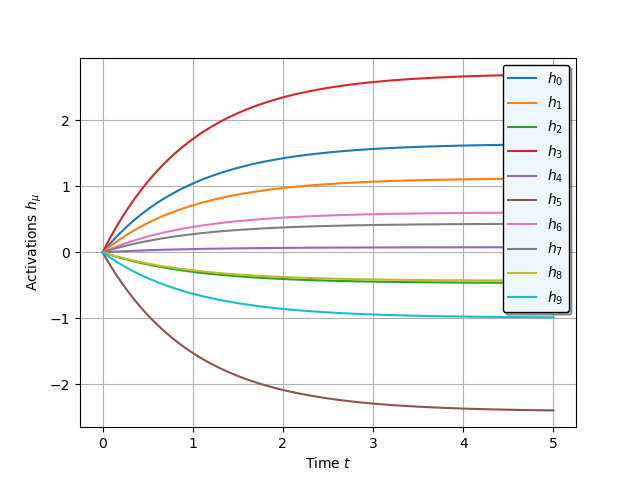

In [ ]:
neurons = BioNeurons(output_dim=10)

t_end = 5
ts = np.linspace(0, t_end, 100)

x = np.random.rand(2)
def activation_evolution(t, w_inh, lebesgue_p):
    neurons.w_inh = w_inh
    neurons.lebesgue_p = lebesgue_p
    
    sol = solve_ivp(neurons.dh_dt, [0, t_end], neurons.activations, args=(x, neurons.weights), t_eval = t)
    
    return sol.y.T


p_values = np.arange(2, 8)

fig, ax = plt.subplots()
controls = iplt.plot(ts, activation_evolution, w_inh=(0, 1, 100), lebesgue_p=p_values,\
     label=[f"$h_{i}$" for i in range(neurons.output_dim)], zorder = 2)
_ = plt.legend(facecolor = 'aliceblue', shadow = True, edgecolor = 'black')
plt.xlabel("Time $t$")
plt.ylabel("Activations $h_\mu$")
plt.grid(zorder = 0)
plt.show()

Down below we show the activations for a $2$ dimensional input $\bar{v} \sim \mathcal{U}(0, 1)$.\
Remeber, the `BioNeurons` class has the parameter `input_dim`, defining the dimension of the input set to $2$ by default.\

BioNeurons(input_dim=2, output_dim=15, w_inh=0.3, delta=0.4, lebesgue_p=2.0, h_star=0.8, tau=1, tau_L=100)


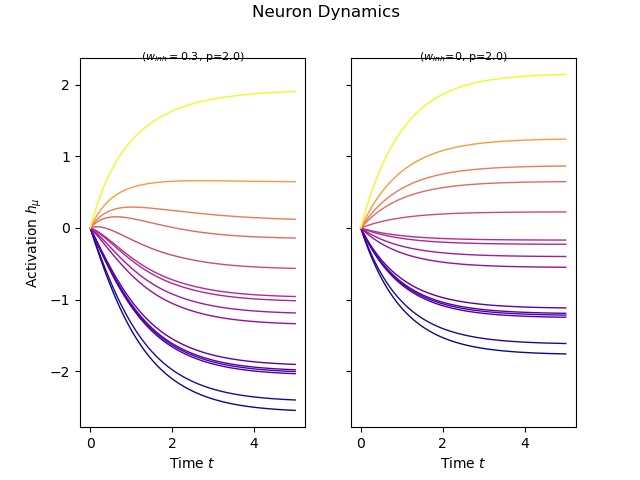

In [ ]:
n_neurons = 15
neurons = BioNeurons(output_dim=n_neurons, w_inh=.3, h_star=.8, lebesgue_p=2.)

t_end = 5
ts = np.linspace(0, t_end, 100)

x = np.random.rand(2)

ts = np.linspace(0, t_end, 100)
sol = solve_ivp(neurons.dh_dt, [0, t_end], neurons.activations, args=(x, neurons.weights), t_eval = ts)  

w_inh = neurons.w_inh

neurons.w_inh = 0
sol2 = solve_ivp(neurons.dh_dt, [0, t_end], neurons.activations, args=(x, neurons.weights), t_eval = ts)  

#with mpl2latex(True):
fig, (ax1, ax2) = plt.subplots(nrows=1, ncols=2, sharey=True)
fig.patch.set_facecolor('none')

currents = neurons.currents(x, weights=neurons.weights, lebesgue_p=neurons.lebesgue_p)
sort_currents = np.argsort(currents)
stat_activations = neurons.stationary_activations(x, neurons.weights)[sort_currents]

colors = plt.cm.plasma((stat_activations - np.min(stat_activations)) / (np.max(stat_activations) - np.min(stat_activations)))

for i, solution in enumerate(sol.y[sort_currents]):
    ax1.plot(ts, solution, color=colors[i], lw=1)

for i, solution in enumerate(sol2.y[sort_currents]):
    ax2.plot(ts, solution, color=colors[i], lw=1)

ax1.set_xlabel('Time $t$')
ax2.set_xlabel('Time $t$')
ax1.set_ylabel(r'Activation $h_\mu$')
ax1.set_title('($w_{inh}=$' + f"{w_inh}, p={neurons.lebesgue_p})", fontsize=8, y=.97)
ax2.set_title('($w_{inh}$=0' + f", p={neurons.lebesgue_p})", fontsize=8, y=.97)
plt.suptitle("Neuron Dynamics", x=.51, y=.99)

ax1.patch.set_facecolor('white')
ax2.patch.set_facecolor('white')
plt.show()

#plt.savefig("Plots/neuron_dynamics.pdf", transparent=True, bbox_inches='tight')

In [ ]:
#Test with MNIST dataset

try: #Load MNIST dataset
    X = np.load("../../data/project/MNIST/MNIST_features.npy", allow_pickle=True)
    y = np.load("../../data/project/MNIST/MNIST_labels.npy", allow_pickle=True)
except IOError: #If not present, download it from the net
    
    X, y = fetch_openml('mnist_784', version=1, return_X_y=True, as_frame=False) #Return tuple (X=features, y=labels) as numpy array
    #(as_frame=False => do not use Pandas DataFrame)

    np.save("../../data/project/MNIST/MNIST_features.npy", X)
    np.save("../../data/project/MNIST/MNIST_labels.npy", y)

X = X/255. #Apply normalization

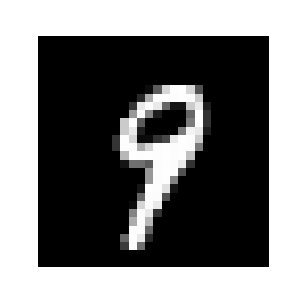

In [ ]:
class RandomPicker():
    def __init__(self, dataset):
        self.dataset = dataset
        
    def __call__(self):
        return random.choice(self.dataset)
    
mnist_sample = RandomPicker(X)

def draw_mnist_sample(data, figsize=(5, 5)):
    """
    Draw a sample from MNIST
    """
    plt.clf()
    plt.figure(figsize = figsize)
    plt.imshow(data.reshape(28, 28), cmap='gray', vmin=0, vmax=1)
    plt.axis('off')
    plt.show()


draw_mnist_sample(mnist_sample(), figsize=(3, 3))

In [ ]:
#Weights evolution
neurons = BioNeurons(output_dim=100, input_dim=28**2, lebesgue_p=2., delta=0.4, h_star=.8, w_inh=15)

BioNeurons(input_dim=784, output_dim=100, w_inh=15, delta=0.4, lebesgue_p=2.0, h_star=0.8, tau=1, tau_L=100)


In general, not all weights are updated at every iteration. This is due to the fact that $g(h) = 0$ is set to $0$ if $h \lt 0$. In this case $\dfrac{dW}{dt}$ is identically set to $0$ by definition and thus we have no weight update.

In [ ]:
neurons.dh_dt( 10e5, np.zeros(neurons.output_dim), mnist_sample(), neurons.weights)

array([ -0.73489538,  -3.34081996,   1.97403519,   3.01957797,
        -0.91751162,   1.45406219,  -8.19003102,   8.57442572,
        -4.61894587,   5.5368226 ,  -0.23548018,   8.18270281,
         1.83773657,  -8.1456739 ,   3.17534775,   1.73329144,
         9.54420281,   8.75441844,   7.1744549 ,  -3.50344489,
       -11.66366674,   7.38756878,   5.54543389,   8.72465663,
        10.98347846,  29.92923402, -12.38062381,  -0.76587   ,
        -0.52416249,   8.46326699,   2.90013341,  -5.35578612,
        12.9922448 ,  -4.16741551, -11.22197851,   1.71384715,
        -9.39304647,   5.11070371, -11.47368302, -11.80599007,
        -0.38961195,   7.99134607,  -0.4088973 ,   2.5334811 ,
        -3.05922509,   7.77458856,  -3.27194633,   9.55651454,
       -16.26298785,  -2.15652007,   2.10213624,   3.65900414,
         0.21719637,  -5.40230134, -10.34105749,  -0.69261356,
         5.30784521,   4.85162326,   0.70985835,   0.56876684,
        10.10354831,  -2.80855337,   1.71771421,   2.50

In [ ]:
neurons.currents(mnist_sample(), neurons.weights, neurons.lebesgue_p)

array([  5.84826884,  -3.0853291 ,  -3.7562477 ,  -4.06248606,
         0.42016107,   0.10043223,  17.57335169,   9.97239497,
       -10.3006285 , -23.47620739,   2.27352872,  -2.00088196,
         0.82032096,  -4.27800271,  25.79918111,   0.15998455,
        -7.15965178,   0.05843516,  -7.71702776,  -7.14407641,
       -15.94255075,  -6.55938673,  10.90975055,  -5.24159316,
        25.73937929,   9.04453365,  -6.87353079,   6.81937157,
         8.10845277,   0.91941277,  11.03673374, -14.19740377,
        14.62190017, -15.1712343 , -19.74255576,  17.74204303,
        -0.73922172,   7.2896323 ,  -3.6013722 ,  -3.78460066,
        26.87738237,  11.21346798,   0.25072183,   8.1927207 ,
         4.28252412,  -4.86822343,   0.94618125,   1.51668086,
       -17.92077313,  -7.24576076,   5.54461256,   6.30523592,
        10.91833922,  -3.39981171, -14.58371714,  21.62883568,
        -3.18300875,   7.19081916,   1.02972973,   5.32247888,
       -12.80402616, -12.70471232,  -3.35068003, -14.20

In [ ]:
eval_time = 5
x = mnist_sample()

#For the given hyperparameters (e.g. delta, w_inh, lebesgue_p...) the percentage of weights that are changed
#in the first iteration is:
non_zero_deltas_percentage=len(np.flatnonzero(neurons.dW_dt(0., neurons.weights, x, flatten=True))) / len(neurons.weights.flatten()) * 100 
#Given the formula of dW_dt, this is the same percentage of non-zero post-activations
print("Percentange of non-zero deltas: {:.2f}%".format(non_zero_deltas_percentage))

Percentange of non-zero deltas: 1.00%


Empirically, the model is most likely to converge (on the **MNIST** dataset) if the percentage of updated weights is around 5-15%. 
A higher number means that there are "too many neurons active at once", and $w_{inh}$ should be set higher to have a higher lateral inhibition.
Otherwise, neurons "won't diversify much", and are likely to converge to very similar patterns.
A lower number means that inhibition is too high, and so the model will take long to converge, or not converge at all.

In [ ]:
%time sol = solve_ivp(neurons.dW_dt, [0, eval_time], neurons.weights.flatten(), args=(x, True), t_eval = [eval_time]) 
#Measure time of an iteration

CPU times: user 11.7 s, sys: 268 ms, total: 12 s
Wall time: 7.53 s


In [ ]:
def draw_weights(weights : np.ndarray,
                 reshape_dim : tuple([int, int]) = (28, 28),
                 max_per_row : int = 5,
                 max_rows : int = 5,
                 fig = None,\
                plot = False): 
    """
    Plot the first few weights as matrices. `weights` should be an array of shape (output_dim, input_dim), i.e.
    `weights[i,j]` is the weight connecting the $j$-th neuron of a layer $n$ to the $i$-th neuron of the $n+1$ layer.
    Namely, all the weights connected to the $i$-th output neuron are the ones in the $i$-th row of `weights`.
    These weights are reshaped according to `reshape_dim` to construct a matrix. The weight matrices of the first neurons
    are then plotted in a grid of up to `max_rows` rows and `max_per_row` columns. 
    """
    
    #Shape of weights is (output_dim, input_dim)
    
    if fig is None:
        fig = plt.figure()
    else:
        plt.clf() #Clears the current figure
    
    nc = np.max(np.abs(weights)) #(Absolute) range of weights
    
    n_neurons = weights.shape[0] 
    
    #---Infer number of rows/columns---#
    n_columns = max_per_row
    n_rows = n_neurons // max_per_row
    

    # Code for showing the weights for each neuron one big image containting all the weights
    
    # Limiting the number of rows to the maximum number needed for a decent visualization
    if n_rows > max_rows:
        n_rows = max_rows
    if n_rows == 1:
        n_columns = n_neurons

    # Limiting the number of neurons to be plotted to the maximum number needed for a decent visualization
    if n_neurons > max_rows * max_per_row:
        n_neurons = max_rows * max_per_row


    
    #---Generate grid---#
    whole_image = np.zeros(reshape_dim * np.array([n_rows, n_columns])) #The created array has shape (n_rows * reshape_dim[0], n_columns * reshape_dim[1])
    
    i_row = 0
    i_col = 0
    size_x, size_y = reshape_dim
    
    plt.tight_layout()
    
    # Put each weight matrix in the right place in the grid
    for index_neuron in range(n_neurons):
        img = weights[index_neuron,].reshape(reshape_dim)
        whole_image[i_row * size_x:(i_row+1) * size_x,i_col * size_y:(i_col+1) * size_y] = img
        i_col += 1
        
        if (i_col >= n_columns):
            i_col = 0
            i_row += 1
    
    
    
    img_plotted = plt.imshow(whole_image, cmap='bwr', vmin=-nc, vmax=nc, interpolation=None)
    
    fig.colorbar(img_plotted, orientation = 'vertical', ax = plt.gca(),ticks=[np.amin(whole_image), 0, np.amax(whole_image)])
    #plt.axis('off')
    if plot:
        plt.show()

In [ ]:
#plt.imshow(whole_image, cmap='bwr', vmin=-nc, vmax=nc, interpolation=None)

## MNIST dataset

Each sample is "shown" to the model for a time `eval_time`, which starts at `eval_time_max` and decreases
linearly to `eval_time_min`. \
The intuition is that, at first, the model needs to "learn from scratch", and
so we go "more slowly".\
Recall that the timescale of plasticity is, by default, 100. Intuitively, the evolution of each weight
takes into consideration mostly the samples falling inside this timescale.\
At the start, we want these to be few, 
so that the neurons "don't get too much confused" and can stick to some specific sample.
Then, when weights are mostly fixed, we can "go faster" and have a lower `eval_time`.\
\
This procedure is motivated by numerical experiments, and is roughly analogous to "lowering the learning rate"
during training of a supervised learning.


In [ ]:
train = False#True

### Training
This cell below implements the "slow" training procedure. We indeed present each smaple one at a time. The dynamic is not discretized and the algorithm is tested on only $300$ samples to avoid long training times.

In [ ]:
#Training loop. ACTUNG! This cell takes a LONG time to execute (4 min on my PC). 
#To just see the results, skip this cell and load the saved weights.

num_trials = 300#10



eval_time_max = 25. 
eval_time_min = 5

all_norms = []


if train:
    for i in tqdm(range(num_trials)):
        x = mnist_sample()
        
        m = (eval_time_max - eval_time_min) / num_trials
        eval_time = eval_time_max - m * i #Time of presentation of a single sample
        
        sol = solve_ivp(neurons.dW_dt, [0, eval_time], neurons.weights.flatten(), args=(x, True), t_eval = [eval_time])
        
        neurons.weights = sol.y.reshape(*neurons.weights.shape)
        norms = np.sum(np.abs(neurons.weights) ** neurons.lebesgue_p, axis=1)
        
        all_norms.append(norms)
        
        #If we wanna draw the weights uncomment the following line
        draw_weights(neurons.weights, fig=fig)
        
        plt.savefig(f"../../data/project/figs_MNIST/weights{i}.png", transparent=True, bbox_inches='tight') #Save images for animation

    #Save weights
    with open('bio_diffeq_converging', 'wb') as file:
        pickle.dump(neurons, file)

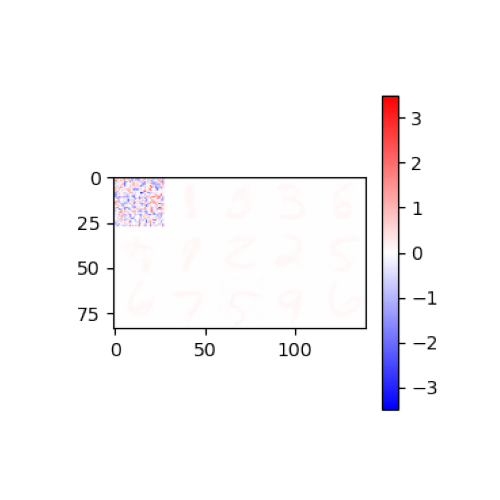

In [ ]:
plt.clf()
fig = plt.figure(figsize=(5,5))
plt.axis("off")
img_list = [plt.imread(f'../../data/project/figs_MNIST/weights{i}.png') for i in range(num_trials)]
ims = [[plt.imshow(img, animated=True, cmap='gray')] for img in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)
HTML(ani.to_jshtml())


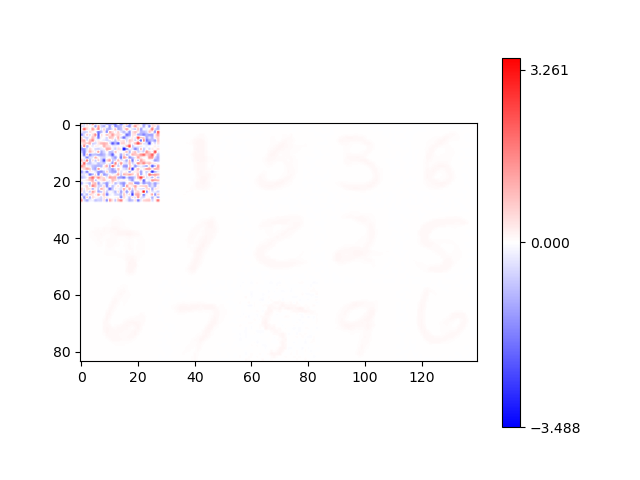

In [ ]:
#Load saved weights and show them

with open('bio_diffeq_converging', 'rb') as file:
    neurons = pickle.load(file)
    
draw_weights(neurons.weights)

## Fast training with PyTorch Lightning

## Data

In [ ]:
#Load (normalized) MNIST dataset, split into train/validation/test, reshape to 1D vectors.

#From: https://pytorch-lightning.readthedocs.io/en/latest/extensions/datamodules.html
class MNISTDataModule(pl.LightningDataModule):
    
    def __init__(self,
                 data_dir : str = '../../data/project/',
                 train_batch_size : int = 100,
                 test_batch_size  : int = 1000):
        
        super().__init__()
        
        #---Store arguments---#
        self.data_dir = data_dir
        self.train_batch_size = train_batch_size
        self.test_batch_size  = test_batch_size
        
        #---Transforms---#
        self.transforms = transforms.Compose([
            transforms.ToTensor(),
            ReshapeTransform((-1,))
            #transforms.Lambda(lambda x: x.double()),
        ])
        
        self.dims = (28**2,)
        
    def setup(self, stage = None):
        if stage == 'fit' or stage is None:
            mnist_full = MNIST(self.data_dir, train=True, transform=self.transforms, download = True)
            self.mnist_train, self.mnist_val = random_split(mnist_full, [50000, 10000]) #Train/Validation split
        
        if stage == 'test' or stage is None:
            self.mnist_test  = MNIST(self.data_dir, train=False, transform=self.transforms)

    def train_dataloader(self):
        return DataLoader(self.mnist_train, batch_size=self.train_batch_size, pin_memory=True, shuffle=True)
    
    def val_dataloader(self):
        return DataLoader(self.mnist_val, batch_size=self.test_batch_size, pin_memory=True)
    
    def test_dataloader(self):
        return DataLoader(self.mnist_test, batch_size=self.test_batch_size, pin_memory=True)


## Optimizer

In [ ]:
class Local(Optimizer):
    """
    A simple optimizer that changes weights according to `weights += learning_rate * delta_weights`,
    for a provided `delta_weights`, automatically retrieving the `learning_rate` from each layer metadata.
    
    Taken from: https://github.com/Joxis/pytorch-hebbian/blob/595ec79577c3816c61d39b0633f8dbf14d28b67a/pytorch_hebbian/optimizers/local.py#L15
    """
    
    def __init__(self, named_params, lr=required):
        self.param_names, params = zip(*named_params)
        
        # torch.optim.optimizer.required checks wheter a particular gradient is required for a parameter
        # during the optimization step.
        if lr is not required and lr < 0.0: 
            raise ValueError("Invalid learning rate: {}".format(lr))
    
        defaults = dict(lr=lr)
        super(Local, self).__init__(params, defaults)
    
    def local_step(self, delta_weights, layer_name, closure=None):
        """Performs a single local optimization step: weights += learning_rate * delta_weights.
        The needed learning_rate is automatically retrieved from the layer metadata."""
        
        loss = None
        if closure is not None:
            loss = closure()
            
        for group in self.param_groups:
            layer_index = self.param_names.index(layer_name + '.weight') #find index of layer
            weights = group['params'][layer_index]
            #print('lr', group['lr'])
            weights.data.add_(group['lr'] * delta_weights)
            #print("Add weights to ", layer_index)
        
        try:
            self._step_count += 1
        except AttributeError:
            pass
        
        return loss

## Learning Rule

In [ ]:
class BioLearningRule():
    """
    Implements the bio-inspired Hebbian learning rule from [1]. 
    
    Adapted from https://github.com/Joxis/pytorch-hebbian/blob/master/pytorch_hebbian/learning_rules/krotov.py
    
    [1]: "Unsupervised learning by competing hidden units", D. Krotov, J. J. Hopfield, 2019, 
         https://www.pnas.org/content/116/16/7723
    """
    
    def __init__(self,
                 precision     : float = 1e-30,
                 delta         : float = 0.4,
                 lebesgue_p    : float = 2.0, 
                 ranking_param : int   = 2):
        """
        Parameters
        ----------
        precision : float
            Minimum value that is considered non-zero.
        delta : float
            Strength of anti-Hebbian learning (from eq. 9 in [1]). 
        lebesgue_p : float
            Parameter for Lebesgue measure, used for defining an inner product (from eq. 2 in [1]).
        ranking_param: int
            Rank of the current to which anti-hebbian learning is applied. Should be >= 2. 
            This is the `k` from eq. 10 in [1].
        """
        
        #Store hyperparameters
        self.precision     = precision
        self.delta         = delta
        self.lebesgue_p    = lebesgue_p
        self.ranking_param = ranking_param
        
        print(self)
        
    def __str__(self):
        """Return string representation of the object"""
        
        return "Krotov-Hopfield Hebbian learning rule (delta={:.2f}, lebesgue_p={:.2f}, ranking_param={})".format(self.delta, self.lebesgue_p, self.ranking_param)
    
    def __repr__(self):
        """Return string representation of the object"""
        
        return str(self)
    
    def __call__(self,
                 inputs  : torch.Tensor,
                 weights : torch.Tensor) -> torch.tensor:
        """
        Compute the change of `weights` given by the Krotov learning rule (eq. 3 from [1], with R=1)
        for a given batch of `inputs`. See "A fast implementation" section in [1].
        
        The formula is:
        ```delta_weights = g(currents) @ inputs - normalization_mtx (*) weights
        currents = (sgn(weights) (*) abs(weights) ** lebesgue_p) @ inputs.T```
        
        where `normalization_mtx` is a matrix of the same shape of `weights`, with all columns equal to:
        ```\sum_{batches} [g(currents) (*) currents]```
        
        The symbol `@` denotes matrix multiplication, while `(*)` is element-wise multiplication (Hadamard product).
        Finally, the function `g` (eq. 10 in [1]) returns:
        ```g(currents[i,j]) = 1      if currents[i,j] is the highest in the j-th column (sample),
                              -Delta if currets[i,j] is the k-th highest value in the j-th column (sample),
                               0     otherwise```
        
         
        Parameters
        ----------
        inputs : torch.Tensor of shape (batch_size, input_size)
            Batch of inputs
        weights : torch.Tensor of shape (output_size, input_size)
            Model's weights
        
        Returns
        -------
        delta_weights : torch.Tensor of shape (output_size, input_size)
            Change of weights given by the fast implementation of Krotov learning rule. The tensor is normalized
            so that its maximum is equal to 1.
        """
        
                
        batch_size = inputs.shape[0]
        
        #---Currents---#
        inputs = torch.t(inputs) #Shape is (batch_size, input_size) -> (input_size, batch_size)
        currents = torch.matmul(torch.sign(weights) * torch.abs(weights) ** (self.lebesgue_p - 1), inputs) #Shape is (output_size, batch_size)
        
        #---Activations---#
        #for the documentation of topk see https://pytorch.org/docs/stable/generated/torch.topk.html
        _, ranking_indices = currents.topk(self.ranking_param, dim=0) #Shape is (self.ranking_param, batch_size)
        #Indices of the top k currents produced by each input sample
        
        post_activation_currents = torch.zeros_like(currents) #Shape is (output_size, batch_size)
        #Computes g(currents)
        #Note that all activations are 0, except the largest current (activation of 1) and the k-th largest (activation of -delta)        
        
        batch_indices = torch.arange(batch_size, device=post_activation_currents.device) 
        post_activation_currents[ranking_indices[0], batch_indices] = 1.0
        post_activation_currents[ranking_indices[self.ranking_param-1], batch_indices] = -self.delta
        
        #---Compute change of weights---#
        delta_weights = torch.matmul(post_activation_currents, torch.t(inputs)) #Overlap between post_activation_currents and inputs
        second_term   = torch.sum(torch.mul(post_activation_currents, currents), dim=1) #Overlap between currents and post_activation_currents
        #Results are summed over batches, resulting in a shape of (output_size,)        
        
        delta_weights = delta_weights - second_term.unsqueeze(1) * weights
        
        #---Normalize---#
        nc = torch.max(torch.abs(delta_weights)) 
        if nc < self.precision:
            nc = self.precision
        
        return delta_weights / nc #Maximum (absolute) change of weight is set to +1. 

In [ ]:
class Net(nn.Module):
    
    def __init__(self, 
                 input_dim : int = 28*28,
                 output_dim : int = 10,
                 num_hidden : int = 2000,
                 n : int = 4.5,
                 beta : float = .1):
        """Builds the standard feed-forward neural network architecture presented in [1].

        Parameters
        ----------
        input_dim : int
            Input dimensionality
        output_dim : int
            Output dimensionality (number of classes)
        num_hidden : int
            Number of hidden units
        n : int
            Exponent of activation function for the first hidden layer (n = 1 for ReLU). See eq. 1 in [1].
        beta : float
            Parameter for the activation function in the top layer (akin to an "inverse temperature"). See eq. 1 in [1].         
        
        [1]: "Unsupervised learning by competing hidden units", D. Krotov, J. Hopfield, 2019
        """
        
        super(Net, self).__init__()
        
        #Store parameters
        self.n = n
        self.beta = beta
        
        #Define layers
        self.num_hidden = num_hidden
        self.hidden = nn.Linear(input_dim, self.num_hidden, bias=False)
        self.top    = nn.Linear(self.num_hidden, output_dim, bias=False)
        
    def forward(self, x : torch.Tensor) -> torch.Tensor:
        """
        Compute the output of the network for the input `x`.
        
        Parameters
        ----------
        x : torch.Tensor of shape (batch_size, self.input_dim)
            Batch of input values
        
        Returns
        -------
        out : torch.Tensor of shape (batch_size, self.output_dim)
            Batch of output values
        """
        
        x = F.relu(self.hidden(x))**self.n
        x = torch.tanh(self.beta * self.top(x))
        
        return x

## Unsupervised phase

In [ ]:
class UnsupervisedPhase(pl.LightningModule):
    """
    Perform unsupervised learning of the first layers of a sequential network according to some local learning rule.
    """

    
    def __init__(self,
                 model               : torch.nn.Sequential,
                 update_weights_rule : Callable,
                 supervised_from     : int = -1,
                 freeze_layers       : List[str] = None,
                 n_epochs            : int = 100,
                 lr                  : float = 0.02
                ):
        """
        Parameters
        ----------
        model : torch.nn.Sequential
            Model to be trained. Must be a sequence of Linear layers (+ some activations).
        update_weights_rule : function
            Function that computes the change of weights
        supervised_from : int
            Train all layers that appear *before* `supervised_from`. By default, all layers except the very last one are trained.
        freeze_layers : list of strings
            Names of layers to be excluded from training.
        n_epochs : int
            Number of epochs for the full training (needed to set the learning rate)
        lr : float
            Initial Learning Rate
        """
        
        super().__init__()
        
        #---Store arguments---#
        self.model           = model
        self.supervised_from = supervised_from
        self.freeze_layers   = freeze_layers
        self.update_weights_rule = update_weights_rule
        self.n_epochs = n_epochs
        self.lr = lr
        
        if self.freeze_layers is None:
            self.freeze_layers = []
            
        self.layers = [] #Save all layers that need to be trained
        Layer = namedtuple('Layer', ['idx', 'name', 'layer']) #simple object to store layer metadata
        
        for idx, (name, layer) in enumerate(list(model.named_children())[:self.supervised_from]):
            if (type(layer) == torch.nn.Linear) and name not in self.freeze_layers:
                self.layers.append(Layer(idx, name, layer))
                
                layer.weight.data.normal_(mean=0.0, std=1.0) #and initialize weights with normal distribution
        
        print("Layers selected for unsupervised local (bio)learning:")
        print("{} layer(s): ".format(len(self.layers)), [lyr.name for lyr in self.layers])
        
        #Register hooks in trainable layers so that input/output can be stored (which is needed for Hebbian learning)
        self._hooks = {} 
        self._inputs = {}
        self._outputs = {}
        
        for layer in self.layers:
            self._hooks[layer.name] = layer.layer.register_forward_hook(
                partial(self._store_data_hook, layer_name=layer.name)
            )
            
        self.automatic_optimization = False #Disable automatic gradient optimizations 
        #(since we are using a local optimizer, which does not need any gradient)
        
    def forward(self, x : torch.Tensor):
        """Compute model output"""
        
        return self.model.forward(x)
    
    def _store_data_hook(self, _, inp, out, layer_name):
        """Hook for storing input/outputs of trainable layers"""
        
        #print("Hook called with name: ", layer_name)
        self._inputs[layer_name] = inp[0]
        self._outputs[layer_name] = out
        
    def training_step(self, batch : torch.Tensor, batch_idx : int):
        """
        Single iteration of the training cycle.
        """
        
        opt = self.optimizers() #Retrieve the optimizer
        
        with torch.no_grad(): #No gradient is needed
            x, y = batch
            
            #---Forward step---#
            layers = list(self.model.children())
            for layer in layers[:self.supervised_from]: 
                x = layer(x)
            
            #---Unsupervised learning---#
            for layer_idx, layer_name, layer in self.layers:
                inputs = self._inputs[layer_name]
                    
                weights = layer.weight
                
                #Compute change of weights
                delta_weights = self.update_weights_rule(inputs, weights)
                delta_weights = delta_weights.view(*layer.weight.size()) #Flatten
                
                #Update weights
                opt.local_step(delta_weights, layer_name=layer_name)
                
        return x, y
        
    def configure_optimizers(self):
        """Define optimizer and learning rate schedule."""
        
        start_lr = self.lr
        optimizer = Local(named_params = self.model.named_parameters(), lr=start_lr)
        lr_scheduler = torch.optim.lr_scheduler.LambdaLR(optimizer, lambda epoch : (self.n_epochs - epoch) / self.n_epochs,
                                                         verbose=True)
        
        return [optimizer], [lr_scheduler]

In [ ]:
class VisualizationCallbacks(pl.Callback):
    """
    Interface with the comet.ml logger to visualize weights during training, and store all hyperparameters of a run.
    """
    
    def __init__(self, step_frequency : int = 250):
        self.step_frequency = step_frequency #Visualize weights every `self.step_frequency` training steps.
    
    @staticmethod
    def draw_weights(weights : np.ndarray,
                     reshape_dim : Tuple[int, int] = (28, 28),
                     max_per_row : int = 5,
                     max_rows : int = 5,
                     epoch : int = -1):
        """
        Plot the first few weights as matrices. `weights` should be an array of shape (output_dim, input_dim), i.e.
        `weights[i,j]` is the weight connecting the $j$-th neuron of a layer $n$ to the $i$-th neuron of the $n+1$ layer.
        Namely, all the weights connected to the $i$-th output neuron are the ones in the $i$-th row of `weights`.
        These weights are reshaped according to `reshape_dim` to construct a matrix. The weight matrices of the first neurons
        are then plotted in a grid of up to `max_rows` rows and `max_per_row` columns. 
        """

        #Shape of weights is (output_dim, input_dim)
        fig = plt.figure()
        nc = np.max(np.abs(weights)) #(Absolute) range of weights

        n_neurons = weights.shape[0] 

        #---Infer number of rows/columns---#
        n_columns = max_per_row
        n_rows = n_neurons // max_per_row

        if n_rows > max_rows:
            n_rows = max_rows
        if n_rows == 1:
            n_columns = n_neurons
        if n_neurons > max_rows * max_per_row:
            n_neurons = max_rows * max_per_row

        #---Generate grid---#
        whole_image = np.zeros(reshape_dim * np.array([n_rows, n_columns]))

        i_row = 0
        i_col = 0
        size_x, size_y = reshape_dim

        plt.clf() #Clear figure
        plt.tight_layout()

        for index_neuron in range(n_neurons):
            img = weights[index_neuron,...].reshape(reshape_dim)
            whole_image[i_row * size_x:(i_row+1) * size_x,i_col * size_y:(i_col+1) * size_y] = img
            i_col += 1

            if (i_col >= n_columns):
                i_col = 0
                i_row += 1

        #---Plot---#
        img_plotted = plt.imshow(whole_image, cmap='bwr', vmin=-nc, vmax=nc, interpolation=None)
        fig.colorbar(img_plotted,ticks=[np.amin(whole_image), 0, np.amax(whole_image)], ax = plt.gca())

        plt.axis('off')
        plt.show()
        
        fig.savefig(f"../../data/project/weightsUnsupervised/weights{epoch}.png", transparent=True, bbox_inches='tight') #Save images for animation
        
        return fig
    
    def on_batch_end(self, trainer, pl_module):
        """
        Draw weights every `self.step_frequency` iterations.
        """
        
        epoch = trainer.current_epoch
        global_step = trainer.global_step
        
        if global_step % self.step_frequency == 0:
            weights = pl_module.model.hidden.weight.detach().cpu().numpy()
            norms = np.sum(np.abs(weights) ** (pl_module.update_weights_rule.lebesgue_p), axis=1)
            print('Normalizations: ', np.mean(norms), ' +- ', np.std(norms))
            fig = self.draw_weights(weights, epoch=epoch)
            pl_module.logger.experiment.log_figure(figure_name="weights", figure=fig, step=global_step)     
            plt.close()
            
        

    def on_train_start(self, trainer, pl_module):
        """
        Store the hyperparameters at the start of training.
        """
        
        pl_module.logger.experiment.log_parameters(
            {'delta': pl_module.update_weights_rule.delta,
             'ranking_param': pl_module.update_weights_rule.ranking_param,
             'lebesgue_p': pl_module.update_weights_rule.lebesgue_p,
             'n': pl_module.model.n,
             'beta' : pl_module.model.beta,
             'arch' : str(pl_module.model)
             }
        )

## Training

In [ ]:
#---Logger---#
#Logs hyperparameters and visualizations on an online server. Requires a free comet.ml account (https://www.comet.ml/).
#The personal api_key should be inserted below.
#The model can run also without the logger: it suffices to remove "callbacks=[visualization]" from the trainer definition.

# comet_logger = CometLogger(
#     api_key="<my_api_key>",
#     project_name="my_project",
#     workspace="my_workspace",
#     experiment_name="unsupervised_biolearning"
# )

visualization = VisualizationCallbacks(step_frequency=500)

#trainer = Trainer(gpus=[0], callbacks=[visualization], max_epochs=200) #Remove gpus=[0] to train using CPU only
trainer = Trainer(max_epochs=200)
#Add logger=comet_logger to log with comet.ml

GPU available: False, used: False
TPU available: None, using: 0 TPU cores


In [ ]:
mnist = MNISTDataModule(train_batch_size=100) #Data
update_weights_rule = BioLearningRule(delta=0.40, lebesgue_p=2, ranking_param=2) #Learning rule
net = Net(28**2, 10, num_hidden=2000) #.double() #Model
print(net)
print(next(net.parameters()).dtype)



NameError: name 'ReshapeTransform' is not defined

In [ ]:
full_system = UnsupervisedPhase(model=net, update_weights_rule=update_weights_rule, n_epochs=trainer.max_epochs, lr=.02) #Assemble!

Layers selected for unsupervised local (bio)learning:
1 layer(s):  ['hidden']


In [ ]:
#trainer.fit(full_system, mnist) #Run training!
#After every epoch, "Normalizations" are printed. These are mean and stdev of \sum_j |W_{ij}|^p.
#When the model converges, mean -> 1 (homeostatic constraint, with R=1)

In [ ]:
#torch.save(next(net.parameters()), "weights")

In [ ]:
#Save model after training

#now = datetime.now()
#date_time_string = now.strftime("%d_%m_%Y-%H_%M")

#checkpoint_name = f"../../data/project/checkpoints/Unsupervised-p{update_weights_rule.lebesgue_p}-k{update_weights_rule.ranking_param}-delta{update_weights_rule.delta}_{date_time_string}.ckpt"
#trainer.save_checkpoint(checkpoint_name) #Move to models/biolearning_mnist_fully_connected

#print(f"Checkpoint saved to {checkpoint_name}")

#torch.save(full_system.model.state_dict(), '../../data/project/models/biolearning_mnist_fully_connected/unsupervised_weights_paper.pth') #Save only state_dict

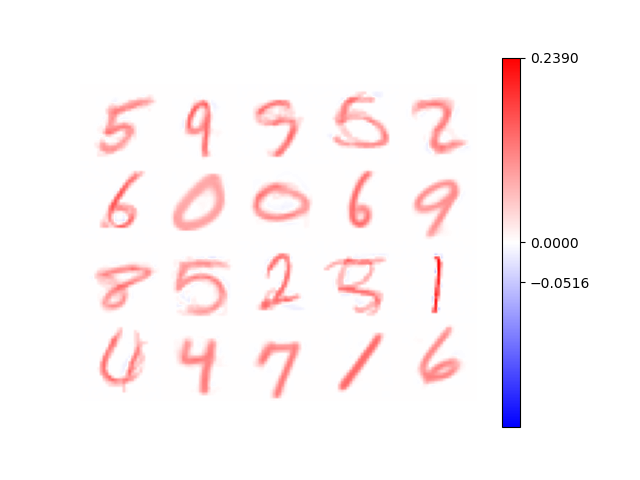

In [22]:
np.random.seed(77)#10
idxPlot = np.random.randint(low = 0, high = 1999, size = 20)
weights = torch.load("../../data/project/weightsUnsupervised/unsupervisedWeights")
weightsPlots = weights.detach().cpu().numpy()[idxPlot]
draw_weights(weightsPlots)
plt.axis('off')
plt.savefig('weightsUnsupervised.png', transparent=True, bbox_inches='tight')

The model has been run with the [fastModel](./fastModel.py) script.\
For the supervised model, we redirect the reader to the [**Supervised Phase**](./supervisedPhase.ipynb) notebook.